### __EFT BOSS WC prior - $p_k$ with $4$ sky-cuts__
Comparison between samples generated with or without the BBN constraint on $\omega_b$. Here, however, we treat the BBN prior as an additional dataset and not as a prior distribution, such as in the BOSS + Planck setup.
- `<distribution>1` : BOSS + BBN,
- `<distribution>2` : BOSS without BBN.

In [1]:
# Import modules and set up plotting
from python_scripts.support import *
%matplotlib inline
%config InlineBackend.figure_format = 'svg'

# Define chain folder
chain_dir = os.path.join(os.getcwd(), 'chains/')

__1. Loading the data__

In [2]:
# First distributions: BOSS + BBN Prior
posterior1 = loadMCSamples(file_root=chain_dir+'eftboss_wc_std/posterior', settings={'ignore_rows':0.})
posterior1.name_tag = 'BOSS + BBN'
# Take the prior from the no_bbn chain
prior1 = loadMCSamples(file_root=chain_dir+'eftboss_wc_nobbn/prior', settings={'ignore_rows':0.})
prior1.name_tag = 'BOSS + BBN Prior'
# Get the parameter limits
param_limits1 = pd.read_csv(chain_dir+'eftboss_wc_nobbn/param_limits.csv', index_col=0)
# Convert to dictionary
param_limits1 = param_limits1.to_dict()
for key in param_limits1.keys():
    param_limits1[key] = (param_limits1[key][0], param_limits1[key][1])

# Second distributions: BOSS
posterior2 = loadMCSamples(file_root=chain_dir+'eftboss_wc_nobbn/posterior', settings={'ignore_rows':0.})
posterior2.name_tag = 'BOSS'
prior2 = loadMCSamples(file_root=chain_dir+'eftboss_wc_nobbn/prior', settings={'ignore_rows':0.})
prior2.name_tag = 'BOSS Prior'
# Get the parameter limits
param_limits2 = pd.read_csv(chain_dir+'eftboss_wc_nobbn/param_limits.csv', index_col=0)
# Convert to dictionary
param_limits2 = param_limits2.to_dict()
for key in param_limits2.keys():
    param_limits2[key] = (param_limits2[key][0], param_limits2[key][1])

# Define the cosmological and nuisance parameter names and labels
params = posterior1.getParamNames().list()
labels = posterior1.getLatex()[0]
# Exclude A_s from the cosmological parameter list to avoid degeneracy with sigma_8
# Exclude Omega_m from the cosmological parameter list to avoid degeneracy with omega_cdm, 
# omega_b and h
params = [param for param in params if ('A' not in param) and ('Omega' not in param)]
labels = [label for label in labels if ('A' not in label) and ('Omega' not in label)]
# Define the nuisance parameter names and labels
nuisance_params = params[4:12]
nuisance_labels = labels[4:12]
# Define the cosmological parameter names and labels
cosmo_params = [param for param in params if param not in nuisance_params]
cosmo_labels = [label for label in labels if label not in nuisance_labels]

__2. Transforming to logarithmic scale__

In [3]:
# Parameters to be transformed to logarithmic scale, excluding A_s
params_tolog = [param for param in cosmo_params if param != 'ln10^{10}A_s']
# Define the labels based on the index of the parameters to be transformed
labels_tolog = [cosmo_labels[cosmo_params.index(param)] for param in params_tolog]

# Transform these parameters to logarithmic scale
for chain in [posterior1, prior1, posterior2, prior2]:
    log_params, log_labels = log_transform(chain, params_tolog, labels_tolog)

__3. CPCA decomposition__

N_eff 	= 3.8339

Improvement factor over the prior in E.U.:
 [6.72 3.36 2.6  1.97 0.61]


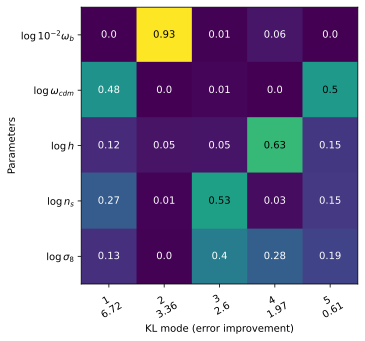

In [4]:
# Plot the fractional CPCA loading matrix on the BOSS + BBN data 
KL_eig1, KL_eigv1, KL_param_names1 = plot_frac_fisher(prior_chain=prior1, posterior_chain=posterior1, 
                                                      params=log_params, labels=log_labels,
                                                      norm=True, figsize=5, print_improvement=True)

We can immediately notice a very high contirbution given by $\omega_b$ to the second mode, whilst this would not happen in the previous case. Furthermore, $n_{eff}$ is now closer to $4$, increasing by one the cardinality of the effective parameter space. These observations are suggesting that $\omega_b$ is now mostly data-constrained.

N_eff 	= 3.0458

Improvement factor over the prior:
 [49.74  7.68  6.    1.57  0.75]
Discarding error units due to negative values.


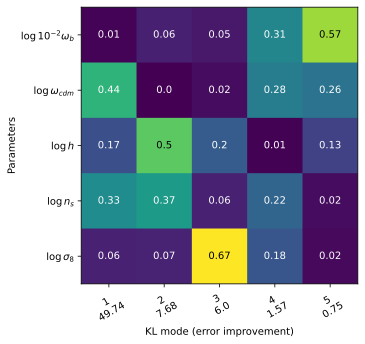

In [5]:
# Do the same on the BOSS data
KL_eig2, KL_eigv2, KL_param_names2 = plot_frac_fisher(prior_chain=prior2, posterior_chain=posterior2, 
                                                      params=log_params, labels=log_labels,
                                                      norm=True, figsize=5, print_improvement=True)

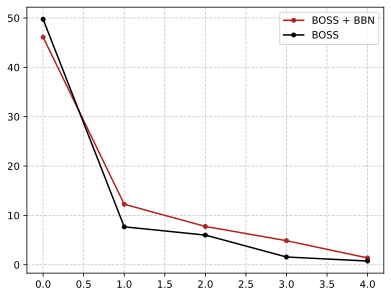

In [6]:
# Plot the scree plot for both datasets: no need to normalize since the eigenvalues are dimensionless
plt.plot(KL_eig1, 'o-', markersize=4, color='firebrick', label='BOSS + BBN')
plt.plot(KL_eig2, 'o-', markersize=4, color='k', label='BOSS')

# Set the legend and the grid
plt.legend()
plt.legend()
plt.grid(linestyle='--', alpha=0.7)
plt.show();

<font size=3>

*__Note__: based on the previous scree plot, we add the first $3$ CPC modes since they preserve the most variance and are mostly correlated with different parameters.*

__4.1 Prior Shrinking__

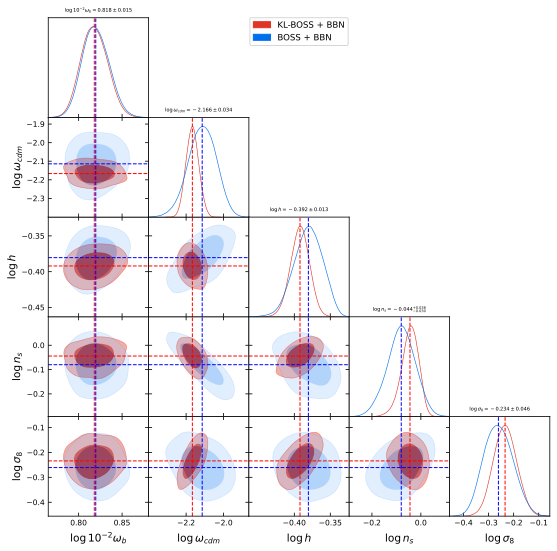

In [7]:
# Push the prior contribution to 0 on the BOSS + BBN data
idx = [posterior1.index[name] for name in KL_param_names1]
prior_mean = prior1.getMeans(pars=[prior1.index[name] for name in KL_param_names1])
posterior_mean = posterior1.getMeans(pars=[posterior1.index[name] for name in KL_param_names1])
inv_KL_eigv1 = np.linalg.inv(KL_eigv1)
# Only keeping the first 4 modes
inv_KL_eigv1[4:,:] = 0.
# Project the shifted posterior samples on the KL modes
KL_filtered_samples1 = np.dot(np.dot(posterior1.samples[:,idx]-prior_mean, KL_eigv1), inv_KL_eigv1)+prior_mean

# Prior Shrinking - Cosmological Parameters
KL_chain1 = MCSamples(samples=KL_filtered_samples1, 
                     loglikes=posterior1.loglikes, 
                     weights=posterior1.weights, 
                     names=KL_param_names1, 
                     labels=[name.label for name in posterior1.getParamNames().parsWithNames(KL_param_names1)], 
                     label='KL-BOSS + BBN',
                     settings={'ignore_rows':0.})
g = plots.get_subplot_plotter(width_inch=9)
g.settings.alpha_filled_add = 0.3
g.settings.title_limit_fontsize = 0.8
# The titles refer to the mean values of the KL posterior distributions
g.triangle_plot([KL_chain1, posterior1], params=KL_param_names1, filled=True, title_limit=1)
KL_means1 = KL_chain1.getMeans(pars=[KL_chain1.index[name] for name in KL_param_names1])
means = posterior1.getMeans(pars=[posterior1.index[name] for name in KL_param_names1])
# Display mean indicators
for i in range(len(KL_param_names1)):
    # Fix the column, change the row -> decreasing from len(cosmo_params)
    for ax in g.subplots[i:,i]:
        ax.axvline(KL_means1[i], color='red', lw=1., ls='--')
        ax.axvline(means[i], color='blue', lw=1., ls='--')
    # Fix the row, change the column -> increasing from 0
    for ax in g.subplots[i,:i]:
        ax.axhline(KL_means1[i], color='red', lw=1., ls='--')
        ax.axhline(means[i], color='blue', lw=1., ls='--')

*__OBS__: $\omega_b$ is now only data-constrained.*

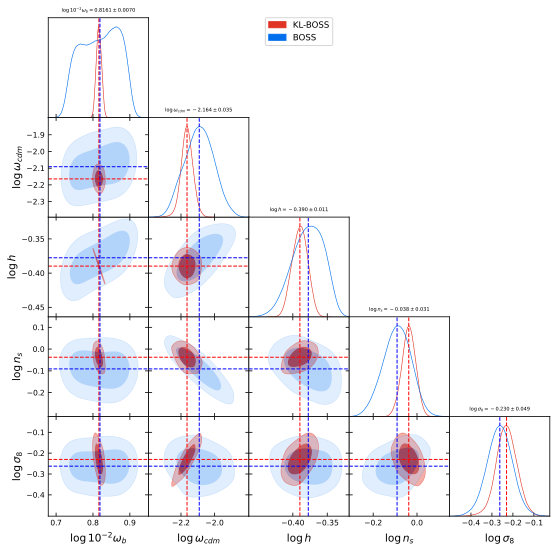

In [8]:
# Push the prior contribution to 0 on the BOSS + BBN data
idx = [posterior2.index[name] for name in KL_param_names2]
prior_mean2 = prior2.getMeans(pars=[prior2.index[name] for name in KL_param_names2])
posterior_mean2 = posterior2.getMeans(pars=[posterior2.index[name] for name in KL_param_names2])
inv_KL_eigv2 = np.linalg.inv(KL_eigv2)
# Only keeping the first 3 modes
inv_KL_eigv2[3:,:] = 0.
# Project the shifted posterior samples on the KL modes
KL_filtered_samples2 = np.dot(np.dot(posterior2.samples[:,idx]-prior_mean2, KL_eigv2), inv_KL_eigv2)+prior_mean2

# Prior Shrinking - Cosmological Parameters
KL_chain2 = MCSamples(samples=KL_filtered_samples2, 
                     loglikes=posterior2.loglikes, 
                     weights=posterior2.weights, 
                     names=KL_param_names2, 
                     labels=[name.label for name in posterior2.getParamNames().parsWithNames(KL_param_names2)], 
                     label='KL-BOSS',
                     settings={'ignore_rows':0.})
g = plots.get_subplot_plotter(width_inch=9)
g.settings.alpha_filled_add = 0.3
g.settings.title_limit_fontsize = 0.8
# The titles refer to the mean values of the KL posterior distributions
g.triangle_plot([KL_chain2, posterior2], params=KL_param_names2, filled=True, title_limit=1)
KL_means2 = KL_chain2.getMeans(pars=[KL_chain2.index[name] for name in KL_param_names2])
means2 = posterior2.getMeans(pars=[posterior2.index[name] for name in KL_param_names2])
# Display mean indicators
for i in range(len(KL_param_names2)):
    # Fix the column, change the row -> decreasing from len(cosmo_params)
    for ax in g.subplots[i:,i]:
        ax.axvline(KL_means2[i], color='red', lw=1., ls='--')
        ax.axvline(means2[i], color='blue', lw=1., ls='--')
    # Fix the row, change the column -> increasing from 0
    for ax in g.subplots[i,:i]:
        ax.axhline(KL_means2[i], color='red', lw=1., ls='--')
        ax.axhline(means2[i], color='blue', lw=1., ls='--')

__4.2 Prior Explosion__

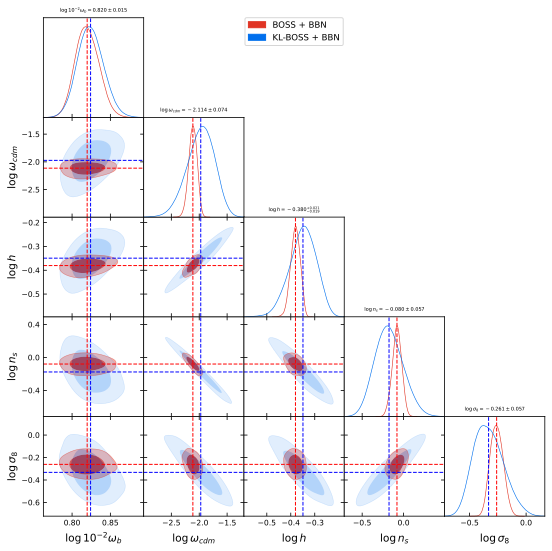

In [9]:
# Push the prior contribution to infinity on the BOSS + BBN data
idx = [posterior1.index[name] for name in KL_param_names1]
prior_mean = prior1.getMeans(pars=[prior1.index[name] for name in KL_param_names1])
inv_KL_eigv = np.linalg.inv(KL_eigv1)
# Invert the values then send them to 0: this is equivalent to set them to infinity
KL_eig_inv1 = 1./KL_eig1
KL_eig_inv1[:4] = 0.
KL_filtered_samples = np.dot(np.dot(np.diag(1./(1.-KL_eig_inv1)), 
                                    np.dot(KL_eigv1.T, (posterior1.samples[:,idx]).T)).T-np.dot(np.diag(1./(1.-KL_eig_inv1)*KL_eig_inv1), 
                                                                                          np.dot(KL_eigv1.T, prior_mean)), 
                                    inv_KL_eigv)
# Define the new chain
KL_chain_exp1 = MCSamples(samples=KL_filtered_samples, 
                     loglikes=posterior1.loglikes, 
                     weights=posterior1.weights, 
                     names=KL_param_names1, 
                     labels=[name.label for name in posterior1.getParamNames().parsWithNames(KL_param_names1)], 
                     label='KL-BOSS + BBN',
                     settings={'ignore_rows':0.})

# Plot the cosmological parameters
g = plots.get_subplot_plotter(width_inch=9)
g.settings.alpha_filled_add = 0.3
g.settings.title_limit_fontsize = 0.8
g.triangle_plot([posterior1, KL_chain_exp1], params=KL_param_names1, filled=True, title_limit=1);
KL_means = KL_chain_exp1.getMeans(pars=[KL_chain_exp1.index[name] for name in KL_param_names1])
means = posterior1.getMeans(pars=[posterior1.index[name] for name in KL_param_names1])
# Display mean indicators
for i in range(len(KL_param_names1)):
    # Fix the column, change the row -> decreasing from len(cosmo_params)
    for ax in g.subplots[i:,i]:
        ax.axvline(KL_means[i], color='blue', lw=1., ls='--')
        ax.axvline(means[i], color='red', lw=1., ls='--')
    # Fix the row, change the column -> increasing from 0
    for ax in g.subplots[i,:i]:
        ax.axhline(KL_means[i], color='blue', lw=1., ls='--')
        ax.axhline(means[i], color='red', lw=1., ls='--')

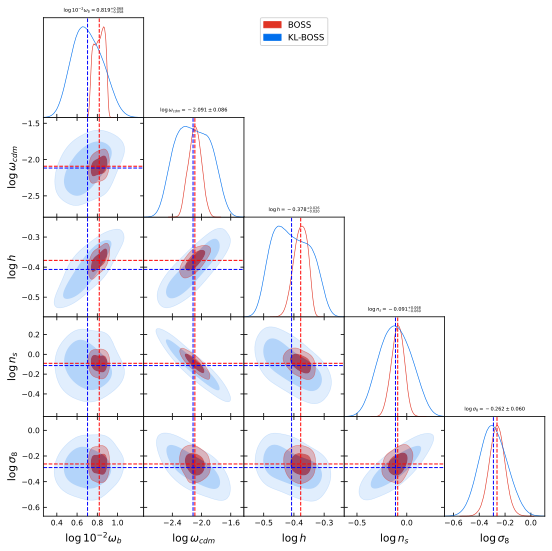

In [10]:
# Push the prior contribution to infinity on the BOSS data
idx = [posterior2.index[name] for name in KL_param_names2]
prior_mean = prior2.getMeans(pars=[prior2.index[name] for name in KL_param_names2])
inv_KL_eigv = np.linalg.inv(KL_eigv2)
# Invert the values then send them to 0: this is equivalent to set them to infinity
KL_eig_inv2 = 1./KL_eig2
KL_eig_inv2[:3] = 0.
KL_filtered_samples = np.dot(np.dot(np.diag(1./(1.-KL_eig_inv2)), 
                                    np.dot(KL_eigv2.T, (posterior2.samples[:,idx]).T)).T-np.dot(np.diag(1./(1.-KL_eig_inv2)*KL_eig_inv2), 
                                                                                          np.dot(KL_eigv2.T, prior_mean)), 
                                    inv_KL_eigv)
# Define the new chain
KL_chain_exp2 = MCSamples(samples=KL_filtered_samples,
                        loglikes=posterior2.loglikes, 
                        weights=posterior2.weights, 
                        names=KL_param_names2, 
                        labels=[name.label for name in posterior2.getParamNames().parsWithNames(KL_param_names2)], 
                        label='KL-BOSS',
                        settings={'ignore_rows':0.})
# Plot the cosmological parameters
g = plots.get_subplot_plotter(width_inch=9)
g.settings.alpha_filled_add = 0.3
g.settings.title_limit_fontsize = 0.8
g.triangle_plot([posterior2, KL_chain_exp2], params=KL_param_names2, filled=True, title_limit=1);
KL_means = KL_chain_exp2.getMeans(pars=[KL_chain_exp2.index[name] for name in KL_param_names2])
means = posterior2.getMeans(pars=[posterior2.index[name] for name in KL_param_names2])
# Display mean indicators
for i in range(len(KL_param_names2)):
    # Fix the column, change the row -> decreasing from len(cosmo_params)
    for ax in g.subplots[i:,i]:
        ax.axvline(KL_means[i], color='blue', lw=1., ls='--')
        ax.axvline(means[i], color='red', lw=1., ls='--')
    # Fix the row, change the column -> increasing from 0
    for ax in g.subplots[i,:i]:
        ax.axhline(KL_means[i], color='blue', lw=1., ls='--')
        ax.axhline(means[i], color='red', lw=1., ls='--')

*Note*: we can notice that, if we include the BBN constraint, removing or exploding the prior does not interfere with $\omega_b$.

__4.3 Prior and posterior comparison__

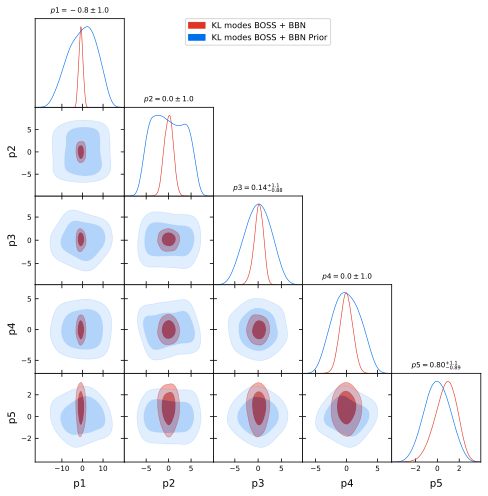

In [11]:
# KL decomposition on the posterior
idx = [posterior1.index[name] for name in KL_param_names1]
prior_mean = prior1.getMeans(pars=[prior1.index[name] for name in KL_param_names1])
temp_names = [f'p{str(i+1)}' for i in range(len(KL_param_names1))]
# Project the shifted posterior samples on the KL modes
KL_filtered_samples = np.dot(posterior1.samples[:,idx] - prior_mean, KL_eigv1)
KL_chain = MCSamples(samples=KL_filtered_samples, 
                     loglikes=posterior1.loglikes, 
                     weights=posterior1.weights, 
                     names=temp_names, 
                     label='KL modes BOSS + BBN')
# KL decomposition on the prior
idx = [prior1.index[name] for name in KL_param_names1]
# Project the shifted prior samples on the KL modes
KL_filtered_prior_samples = np.dot(prior1.samples[:,idx] - prior_mean, KL_eigv1)
KL_prior_chain = MCSamples(samples=KL_filtered_prior_samples, 
                     loglikes=prior1.loglikes, 
                     weights=prior1.weights, 
                     names=temp_names, 
                     label='KL modes BOSS + BBN Prior')
# Plot the KL modes
g = plots.get_subplot_plotter(width_inch=8)
g.settings.alpha_filled_add = 0.3
g.triangle_plot([KL_chain, KL_prior_chain], params=temp_names, 
                filled=True, title_limit=1);

*Note*: tight distributions for mode $1$ and mode $2$. The BBN constraint helps the parameters to suffer less from the effect of the prior, as well as the modes to retain more variance.

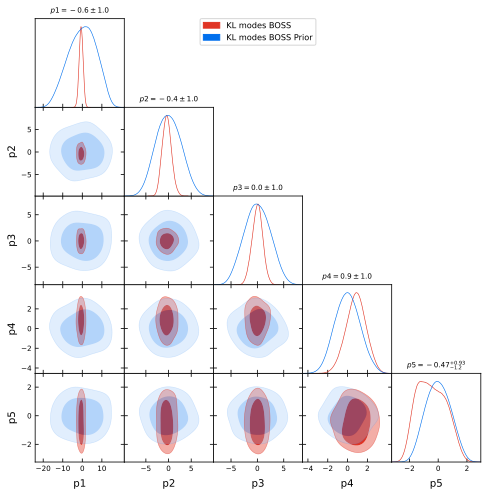

In [12]:
# Repeat the process for the BOSS data
idx = [posterior2.index[name] for name in KL_param_names2]
prior_mean = prior2.getMeans(pars=[prior2.index[name] for name in KL_param_names2])
temp_names = [f'p{str(i+1)}' for i in range(len(KL_param_names2))]
# Project the shifted posterior samples on the KL modes
KL_filtered_samples = np.dot(posterior2.samples[:,idx] - prior_mean, KL_eigv2)
KL_chain = MCSamples(samples=KL_filtered_samples, 
                     loglikes=posterior2.loglikes, 
                     weights=posterior2.weights, 
                     names=temp_names, 
                     label='KL modes BOSS')
# KL decomposition on the prior
idx = [prior2.index[name] for name in KL_param_names2]
# Project the shifted prior samples on the KL modes
KL_filtered_prior_samples = np.dot(prior2.samples[:,idx] - prior_mean, KL_eigv2)
KL_prior_chain = MCSamples(samples=KL_filtered_prior_samples, 
                     loglikes=prior2.loglikes, 
                     weights=prior2.weights, 
                     names=temp_names, 
                     label='KL modes BOSS Prior')
# Plot the KL modes
g = plots.get_subplot_plotter(width_inch=8)
g.settings.alpha_filled_add = 0.3
g.triangle_plot([KL_chain, KL_prior_chain], params=temp_names, 
                filled=True, title_limit=1);

__5. Best-constrained parameters__

In [13]:
from tensiometer_dev.tensiometer import *
# Print CPC parameter combinations
dict1 = gaussian_tension.linear_CPCA_chains(prior1, posterior1, param_names=log_params)
dict2 = gaussian_tension.linear_CPCA_chains(prior2, posterior2, param_names=log_params)

# Define the start and end string delimiting the text to be printed
start = 'CPC parameter combinations:'
end = 'CPC modes parameters correlations'
s = gaussian_tension.print_CPCA_results(dict1)
print('BOSS + BBN CPC Parameter Combinations', end=' ')
print(s[s.find(start)+len(start):s.rfind(end)])
s = gaussian_tension.print_CPCA_results(dict2)
print('\n\nBOSS CPC Parameter Combinations', end=' ')
print(s[s.find(start)+len(start):s.rfind(end)])

BOSS + BBN CPC Parameter Combinations 
   1 :   45.119 (   671.7 %)
      +1.00*(\log \omega{}_{cdm } +2.11) -1.21*(\log h +0.38) +0.94*(\log n_{s } +0.08) +0.19*(\log \sigma_8 +0.26) = 0 +- 0.038 (post) / 0.26 (prior)
   2 :   11.256 (   335.5 %)
      +1.00*(\log 10^{-2}\omega{}_{b } -0.82) = 0 +- 0.015 (post) / 0.052 (prior)
   3 :    6.754 (   259.9 %)
      +1.00*(\log n_{s } +0.08) -0.67*(\log \sigma_8 +0.26) = 0 +- 0.046 (post) / 0.13 (prior)
   4 :    3.873 (   196.8 %)
      +1.00*(\log h +0.38) +0.19*(\log \sigma_8 +0.26) = 0 +- 0.02 (post) / 0.044 (prior)
   5 :    0.372 (    61.0 %)
      +1.00*(\log \omega{}_{cdm } +2.11) +3.01*(\log h +0.38) -0.33*(\log n_{s } +0.08) -1.02*(\log \sigma_8 +0.26) = 0 +- 0.16 (post) / 0.19 (prior)




BOSS CPC Parameter Combinations 
   1 :   48.738 (   698.1 %)
      +1.00*(\log \omega{}_{cdm } +2.09) -1.42*(\log h +0.38) +1.02*(\log n_{s } +0.09) = 0 +- 0.034 (post) / 0.24 (prior)
   2 :    6.683 (   258.5 %)
      +1.00*(\log h +0.38) +0.

In [14]:
# Use the first 3 modes derived from the BOSS + BBN data to project both datasets
# Add the derived parameters (new modes) to a copy of the original chain
temp_chain1 = posterior1.copy()
temp_chain2 = posterior2.copy()
p1 = temp_chain1.getParams()
p2 = temp_chain2.getParams()

# Add the new parameters to the first chain
temp_chain1.addDerived(p1.omega_cdm**1. * p1.h**(-1.21) * p1.n_s**0.94 * p1.sigma8**0.19, name='p1', 
                       label='p_1 = \\frac{\omega_{cdm} n_s^{0.94} \sigma_8^{0.19}}{h^{1.21}}')
temp_chain1.addDerived(p1.omega_b, name='p2', label='p_2 = \omega_{b}')
temp_chain1.addDerived(p1.n_s**1. * p1.sigma8**(-0.67), name='p3', label='p_3 = \\frac{n_s}{\sigma_8^{0.67}}')

# Add the new parameters to the second chain
temp_chain2.addDerived(p2.omega_cdm**1. * p2.h**(-1.42) * p2.n_s**(1.02), name='p1', 
                       label='\\frac{\omega_{cdm} n_s^{1.02}}{h^{1.42}}')
temp_chain2.addDerived(p2.h**1. * p2.n_s**0.31, name='p2', label='h n_s^{0.31}')
temp_chain2.addDerived(p2.h**2.27 * p2.sigma8**1., name='p3', label='h^{2.27} \sigma_8')

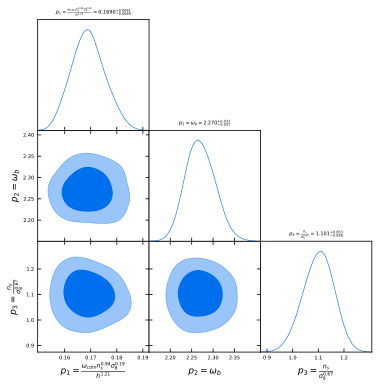

In [15]:
# Plot the new parameters
g = plots.get_subplot_plotter(width_inch=6)
g.settings.alpha_filled_add = 0.3
g.settings.axes_fontsize = 1
g.settings.axes_labelsize = 12
g.triangle_plot([temp_chain1], params=['p1', 'p2', 'p3'], filled=True, title_limit=1)

*Note*: the second mode is totally degenerate with $\omega_b$.

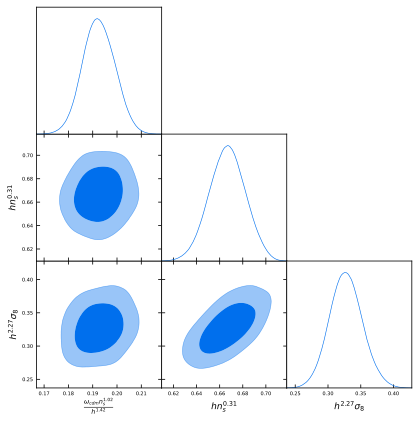

In [16]:
# Plot the new parameters
g = plots.get_subplot_plotter(width_inch=6)
g.settings.alpha_filled_add = 0.3
g.settings.axes_fontsize = 1
g.settings.axes_labelsize = 12
g.triangle_plot([temp_chain2], params=['p1', 'p2', 'p3'], filled=True)

In [17]:
# Graphic evaluation
g = plots.get_subplot_plotter(width_inch=7)
g.settings.alpha_filled_add = 0.3
# Compare the KL-filtered chains with the original ones, using null priors and the full set of parameters
g.triangle_plot([posterior1, KL_chain1, posterior2, KL_chain2], 
                params=['log_omega_cdm', 'log_n_s', 'log_h', 'log_sigma8', 'log_omega_b'], 
                filled=True)

The marginalized distributions inherent to $\omega_b$ present good overlapping except for the __BBN-free original data__. The BBN data constrains $\omega_b$, but its prior is poorly informative.

In [18]:
# Graphic evaluation
g = plots.get_subplot_plotter(width_inch=7)
g.settings.alpha_filled_add = 0.3
# Compare the KL-filtered chains with the original ones, using exploded priors
g.triangle_plot([posterior1, KL_chain_exp1, posterior2, KL_chain_exp2], 
                params=['log_omega_cdm', 'log_n_s', 'log_h', 'log_sigma8', 'log_omega_b'], 
                filled=True)

*Note*: the prior explosion highlights the different prior impact. On one hand, we observe good overlapping between the original distributions. On the other hand, only $\sigma_8$ and $n_s$ KL-distributions look similar.\
Notice the different behavior of $\omega_b$: the BBN-free distribution looks much wider and non-gaussian, while the other one is very tight and looks perfectly gaussian.

__6. Tension Estimates__

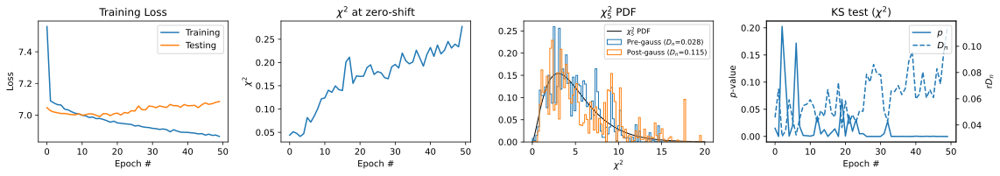

256/256 [==============================] - 8s 32ms/step - loss: 6.8653 - val_loss: 7.0859 - shift0_chi2: 0.2773 - shift0_pval: 0.0020 - shift0_nsigma: 0.0024 - chi2Z_ks: 0.1151 - chi2Z_ks_p: 7.7661e-14 - lr: 0.0010
Training completed.
Time taken to train the model: 517.1448800563812 seconds


In [19]:
from python_scripts.flow import *
# Create a DiffFlow object
flow = DiffFlow(posterior1, posterior2, params=cosmo_params, labels=cosmo_labels)
# Build the difference chains
flow.build_diff()

# Train the Normalizing Flow model
# Print the time taken to train the model
import time
start = time.time()
flow.train(eta=0.001, epochs=50, batch_size=1024, steps_per_epoch=256)
end = time.time()
print('Time taken to train the model: {} seconds'.format(end-start))

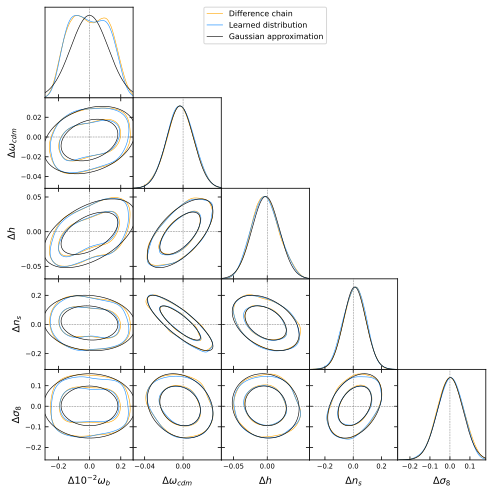

In [20]:
# Plot the learned and the approximated distributions, as well as the difference chain
flow.plot_distributions()

In [21]:
# Print the shift estimate, also in number of sigmas
flow.estimate_shift()

Considering ['delta_omega_b', 'delta_omega_cdm', 'delta_h', 'delta_n_s', 'delta_sigma8'] parameters...
Shift probability = 0.03335 + 0.00188 - 0.00179
          n_sigma = 0.042


Previous results:\
`Shift probability = 0.02197 + 0.00156 - 0.00146`\
`n_sigma = 0.028`\
As expected, the shift probability is basically unvaried, because the data are the same. We just changed the *interpretation* of the BBN prior.

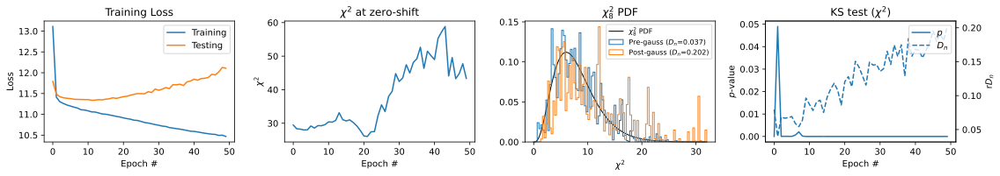

256/256 [==============================] - 21s 81ms/step - loss: 10.4680 - val_loss: 12.1072 - shift0_chi2: 43.3743 - shift0_pval: 1.0000 - shift0_nsigma: 4.9488 - chi2Z_ks: 0.2018 - chi2Z_ks_p: 6.6787e-42 - lr: 0.0010
Training completed.
Time taken to train the model: 917.6947610378265 seconds


In [22]:
# Use the EFT parameters to train the model
from python_scripts.flow import *
# Create a DiffFlow object
flow = DiffFlow(posterior1, posterior2, params=nuisance_params, labels=nuisance_labels,)
# Build the difference chains
flow.build_diff()

# Train the Normalizing Flow model
# Print the time taken to train the model
import time
start = time.time()
flow.train(eta=0.001, epochs=50, batch_size=1024, steps_per_epoch=256)
end = time.time()
print('Time taken to train the model: {} seconds'.format(end-start))

In [23]:
# Plot the learned and the approximated distributions, as well as the difference chain
flow.plot_distributions()

In [24]:
# Print the shift estimate, also in number of sigmas
flow.estimate_shift()

Considering ['delta_b1_hN', 'delta_c2_hN', 'delta_b1_hS', 'delta_c2_hS', 'delta_b1_lN', 'delta_c2_lN', 'delta_b1_lS', 'delta_c2_lS'] parameters...
Shift probability = 1.00000 + nan - 0.00016
          n_sigma = 5.542
